In [ ]:
!git clone https://github.com/facebookresearch/segment-anything-2.git

%cd segment-anything-2
!pip install -e .

Cloning into 'segment-anything-2'...
remote: Enumerating objects: 906, done.
remote: Counting objects: 100% (270/270), done.
remote: Compressing objects: 100% (113/113), done.
remote: Total 906 (delta 177), reused 167 (delta 157), pack-reused 636 (from 1)
Receiving objects: 100% (906/906), 115.97 MiB | 14.01 MiB/s, done.
Resolving deltas: 100% (294/294), done.
/content/segment-anything-2
Obtaining file:///content/segment-anything-2
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 14.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pip install pycocotools


In [ ]:
%cd /content/segment-anything-2/checkpoints
!./download_ckpts.sh

/content/segment-anything-2/checkpoints
--2024-09-30 08:29:35--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_tiny.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.24.72, 3.163.24.51, 3.163.24.93, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.24.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 156008466 (149M) [application/vnd.snesdev-page-table]
Saving to: ‘sam2.1_hiera_tiny.pt’

sam2.1_hiera_tiny.p 100%[===================>] 148.78M   259MB/s    in 0.6s    

2024-09-30 08:29:36 (259 MB/s) - ‘sam2.1_hiera_tiny.pt’ saved [156008466/156008466]

--2024-09-30 08:29:36--  https://dl.fbaipublicfiles.com/segment_anything_2/092824/sam2.1_hiera_small.pt
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 3.163.24.72, 3.163.24.51, 3.163.24.93, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|3.163.24.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Le

##### We uploaded the "sam2_hiera_tiny.pt" file in the checkpoints folder manually.

In [ ]:
%cd ..

In [ ]:
import torch
import torch.cuda
from sam2.build_sam import build_sam2
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator
from sam2.sam2_image_predictor import SAM2ImagePredictor
from sam2.build_sam import build_sam2_video_predictor
from PIL import Image, ImageOps
import numpy as np
import matplotlib.pyplot as plt
import os,glob,shutil
import zipfile
import matplotlib.patches as patches

/content/segment-anything-2/sam2/modeling/sam/transformer.py:23: UserWarning: Flash Attention is disabled as it requires a GPU with Ampere (8.0) CUDA capability.
  OLD_GPU, USE_FLASH_ATTN, MATH_KERNEL_ON = get_sdpa_settings()


In [ ]:
# select the device for computation
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
else:
    device = torch.device("cpu")
print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS."
         "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )


using device: cuda


In [ ]:
checkpoint = "/content/segment-anything-2/checkpoints/sam2_hiera_tiny.pt"
model_cfg = "sam2_hiera_t.yaml"
predictor_prompt = SAM2ImagePredictor(build_sam2(model_cfg, checkpoint))
sam2 = build_sam2(model_cfg, checkpoint, device='cuda', apply_postprocessing=False)
mask_generator = SAM2AutomaticMaskGenerator(sam2)
predictor_vid = build_sam2_video_predictor(model_cfg, checkpoint, device='cuda')

In [ ]:
tempfolder = "./tempdir"

In [ ]:
def create_if_not_exists(dirname):
  if not os.path.exists(dirname):
    os.mkdir(dirname)
def cleardir(tempfolder):
  filepaths = glob.glob(tempfolder+"/*")
  for filepath in filepaths:
    os.unlink(filepath)
def show_mask(mask, ax, obj_id=None, random_color=False):
  if random_color:
    color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
  else:
    cmap = plt.get_cmap("tab10")
    cmap_idx = 0 if obj_id is None else obj_id
    color = np.array([*cmap(cmap_idx)[:3], 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

def show_points(coords, labels, ax, marker_size=200):
  pos_points = coords[labels==1]
  neg_points = coords[labels==0]
  ax.scatter(pos_points[:, 0], pos_points[:, 1], color='green', marker='*', s=marker_size)
  ax.scatter(neg_points[:, 0], neg_points[:, 1], color='red', marker='*', s=marker_size)
def show_box(box, ax):
  x0, y0 = box[0], box[1]
  w, h = box[2] - box[0], box[3] - box[1]
  ax.add_patch(plt.Rectangle((x0, y0), w, h, edgecolor='green', facecolor=(0,0,0,0),lw=2))

In [ ]:
def track_item_boxes(imgpath1,imgpath2,img1boxclasslist,visualize=True):

# imgpath1 :: Image where object is known
# imgpath2 :: Image where object is to be tracked
# img1boxclasslist :: [ ([xmin,xmax,ymin,ymax],objectnumint) ,....] for all objects in imagepath1
  create_if_not_exists(tempfolder)
  cleardir(tempfolder)
  shutil.copy(imgpath1,tempfolder+"/00000.jpg")
  shutil.copy(imgpath2,tempfolder+"/00001.jpg")
  inference_state = predictor_vid.init_state(video_path="./tempdir")
  predictor_vid.reset_state(inference_state)
  ann_frame_idx = 0
  for img1boxclass in img1boxclasslist:
    ([xmin,xmax,ymin,ymax],objectnumint) = img1boxclass
    box = np.array([xmin, ymin, xmax, ymax], dtype=np.float32)
    _, out_obj_ids, out_mask_logits = predictor_vid.add_new_points_or_box(
        inference_state=inference_state,
        frame_idx=ann_frame_idx,
        obj_id=objectnumint,
        box=box,
      )
  video_segments = {} # video_segments contains the per-frame segmentation results
  for out_frame_idx, out_obj_ids, out_mask_logits in predictor_vid.propagate_in_video(inference_state=inference_state):
    video_segments[out_frame_idx] = {
        out_obj_id: (out_mask_logits[i] > 0.0).cpu().numpy()
        for i, out_obj_id in enumerate(out_obj_ids)
}
  if visualize:
    fig, ax = plt.subplots()
    plt.title(f"original image object ::")
    ax.imshow(Image.open(tempfolder+"/00000.jpg"))
    rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1, edgecolor="r")
    ax.add_patch(rect)
    plt.show()
    out_frame_idx = 1
    plt.figure(figsize=(6, 4))
    plt.title(f"detected object in test image ::")
    plt.imshow(Image.open(tempfolder+"/00001.jpg"))
    for out_obj_id, out_mask in video_segments[out_frame_idx].items():
      show_mask(out_mask, plt.gca(), obj_id=out_obj_id)
  return video_segments

In [ ]:
def process_img_png_mask(img_path, mask_path, visualize=False):
    """
    Processes an image and its corresponding mask to calculate the bounding box
    (xmin, xmax, ymin, ymax) for the object in the image, and visualizes the image, mask,
    and the cropped object.

    Args:
        img_path (str): Path to the image file.
        mask_path (str): Path to the mask file (PNG).
        visualize (bool): Whether to visualize the image, mask, and cropped object.

    Returns:
        tuple: (xmin, xmax, ymin, ymax) coordinates of the bounding box.
    """
    # Load image and mask
    image = Image.open(img_path)
    mask = Image.open(mask_path)

    # Convert mask to a NumPy array and get non-zero pixels (object area)
    mask_np = np.array(mask)
    object_pixels = np.argwhere(mask_np > 0)  # Get non-zero pixels where mask is present

    # Calculate bounding box coordinates from the mask
    ymin, xmin = np.min(object_pixels, axis=0)
    ymax, xmax = np.max(object_pixels, axis=0)

    # Visualize the image, mask, and cropped object if needed
    if visualize:
        fig, ax = plt.subplots(1, 3, figsize=(18, 6))

        # Display the original image
        ax[0].imshow(image)
        ax[0].set_title('Original Image')

        # Overlay the mask on the original image
        ax[1].imshow(image)
        mask_overlay = np.zeros((mask_np.shape[0], mask_np.shape[1], 4))  # RGBA for transparency
        mask_overlay[mask_np > 0, 3] = 0.5  # Add transparency to the mask
        ax[1].imshow(mask_overlay)
        ax[1].set_title('Mask Overlay')

        # Draw the bounding box
        rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, linewidth=2, edgecolor='r', facecolor='none')
        ax[1].add_patch(rect)

        # Extract the cropped object using the bounding box
        cropped_object = image.crop((xmin, ymin, xmax, ymax))
        ax[2].imshow(cropped_object)
        ax[2].set_title('Extracted Object')

        plt.tight_layout()
        plt.show()

    return xmin, xmax, ymin, ymax


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Unzip the dataset
def unzip_dataset(zip_path, extract_to):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)

# Paths and directories
zip_path = '/content/drive/MyDrive/CMU10_3D.zip'
extract_to = '/content/segment-anything-2/CMU10_3D'

unzip_dataset(zip_path, extract_to)

In [ ]:
# List the product folders inside 'data_2D'
data_2d_dir = os.path.join(extract_to, 'CMU10_3D','data_2D')
product_image_list = glob.glob(os.path.join(data_2d_dir, "*_000001.jpg"))

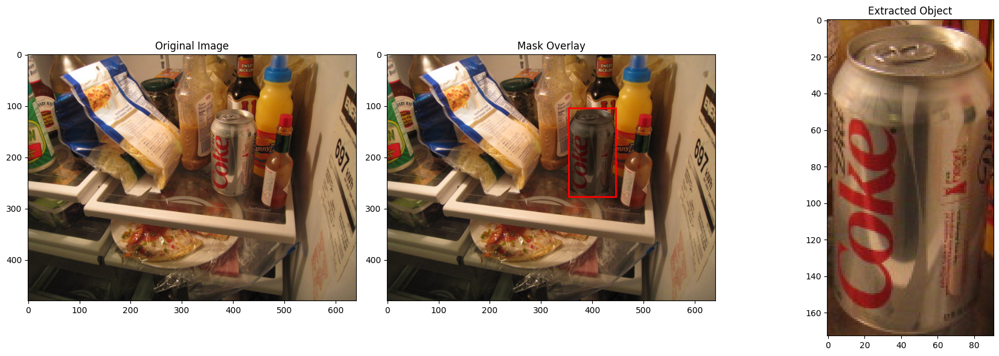

propagate in video: 100%|██████████| 2/2 [00:00<00:00,  7.28it/s]


creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0

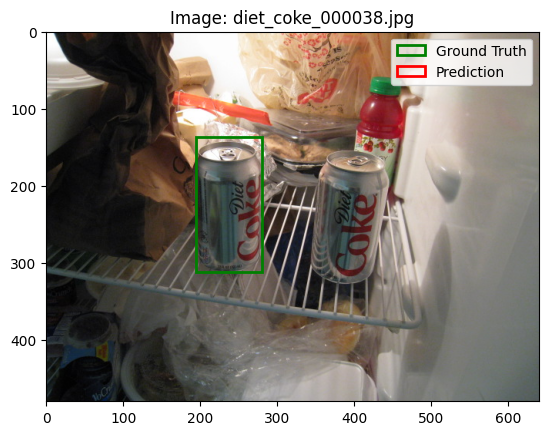

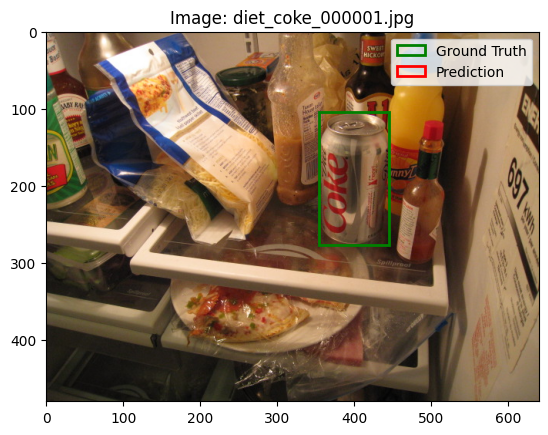

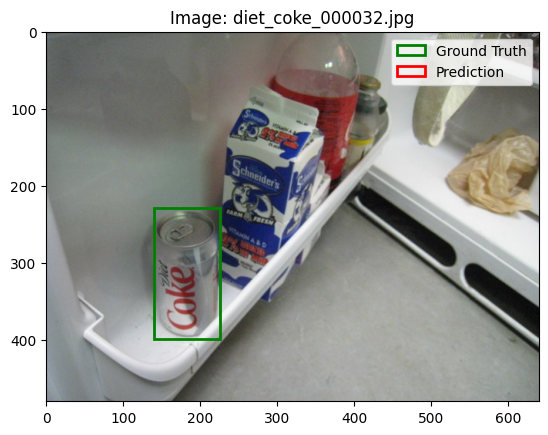

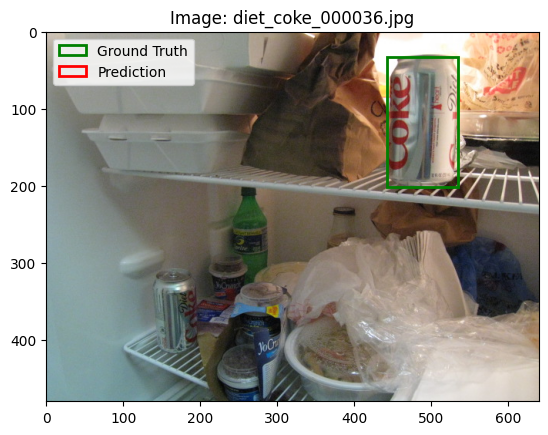

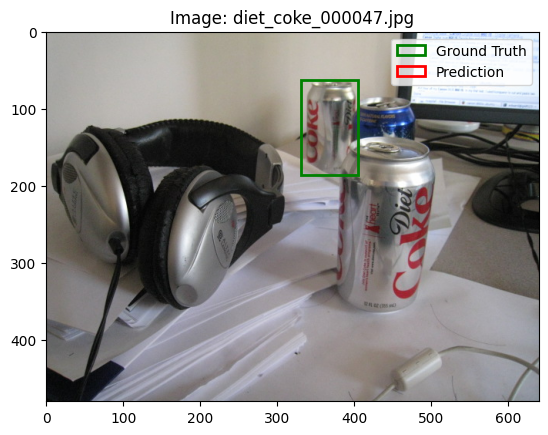

...

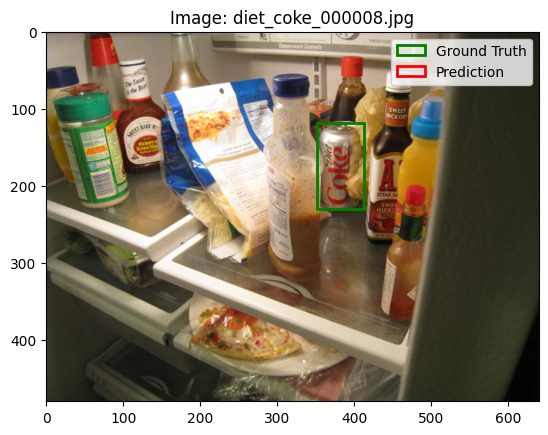

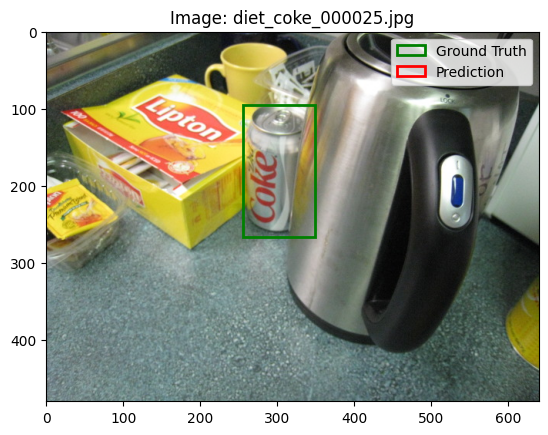

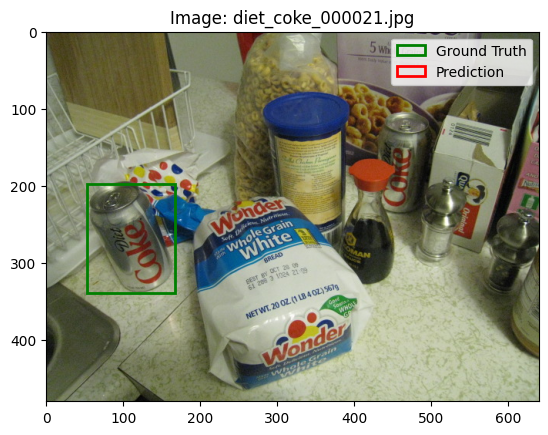

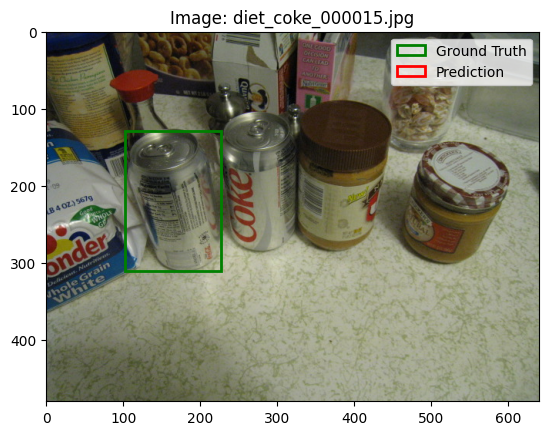

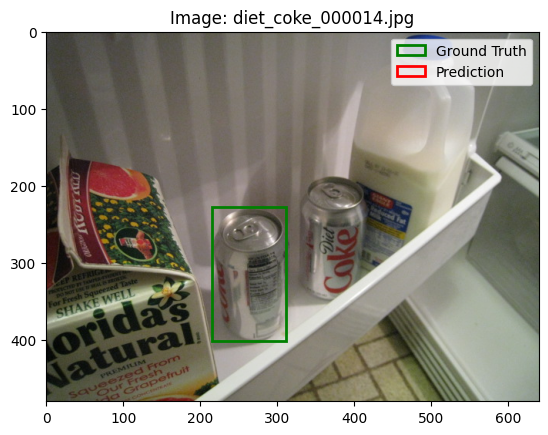

Performance for diet_coke_000001.jpg: 0.0


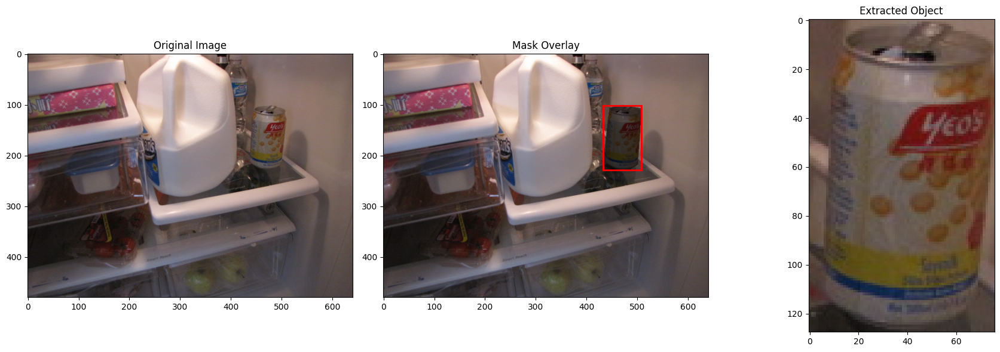

propagate in video: 100%|██████████| 2/2 [00:00<00:00,  7.25it/s]


creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.03s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0

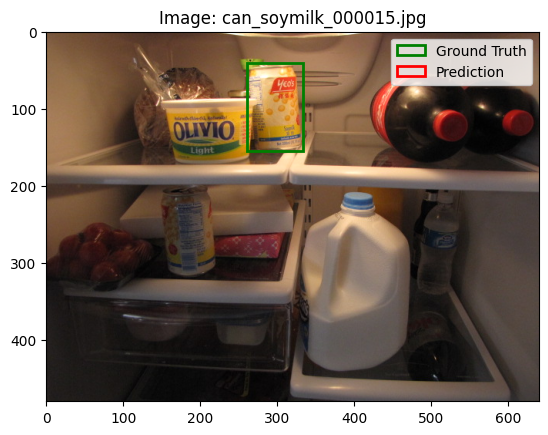

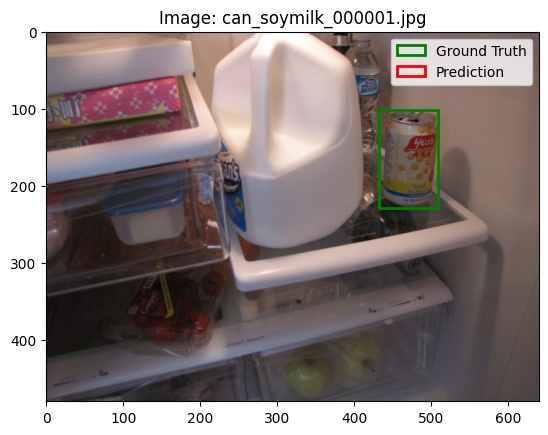

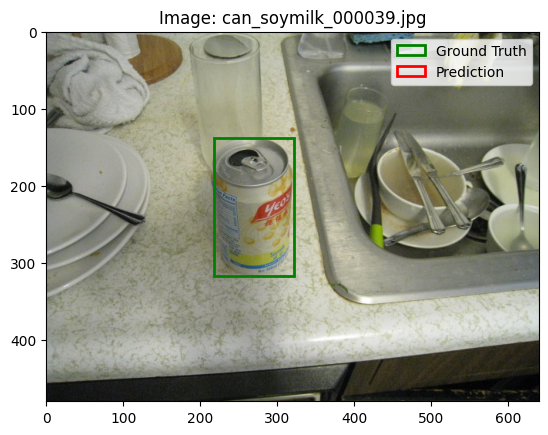

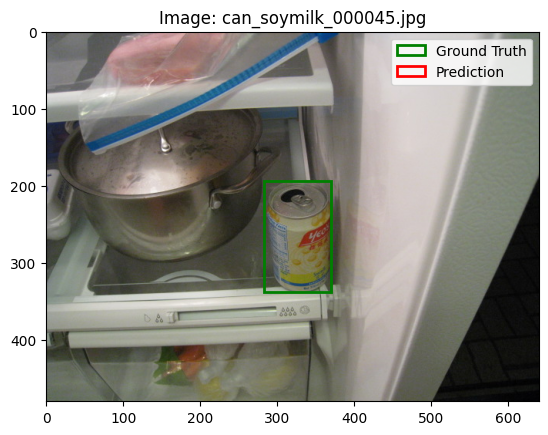

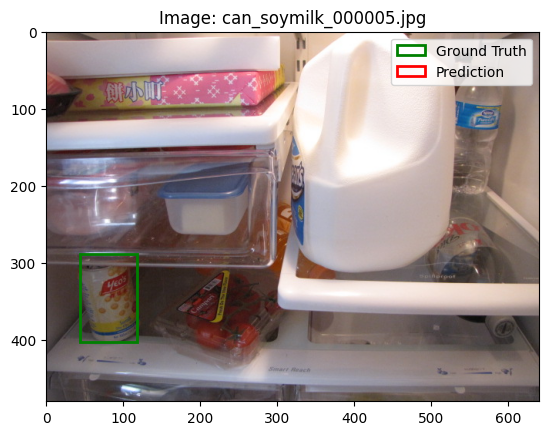

...

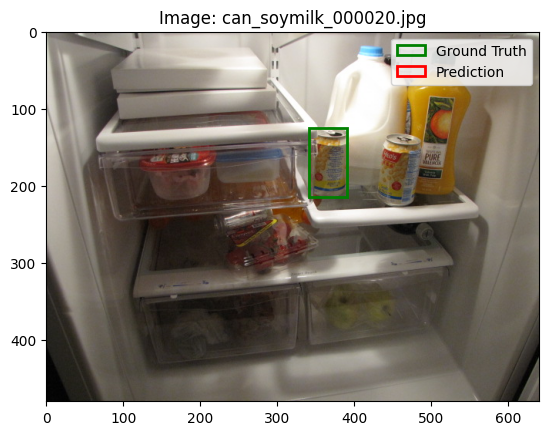

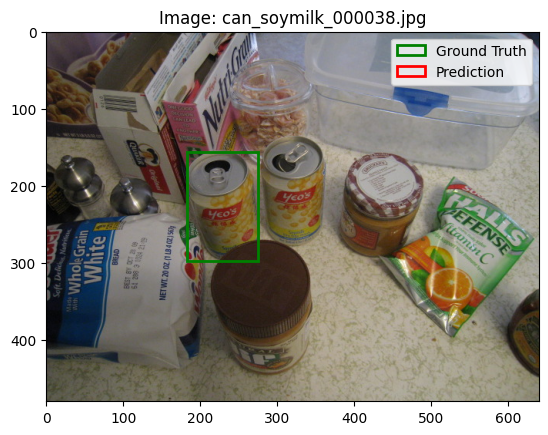

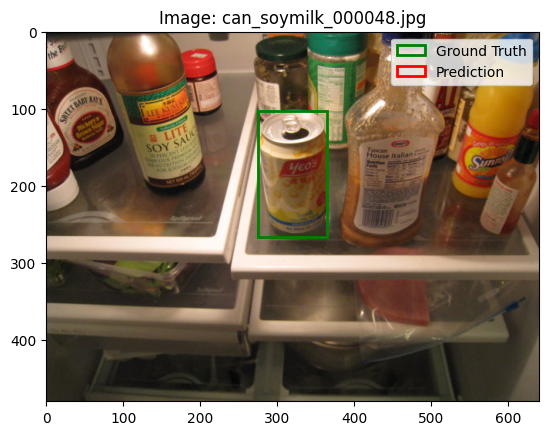

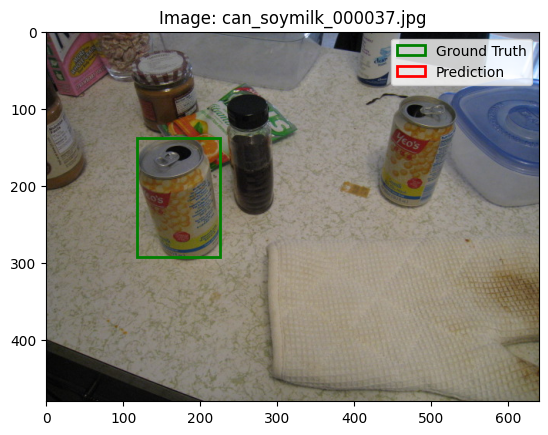

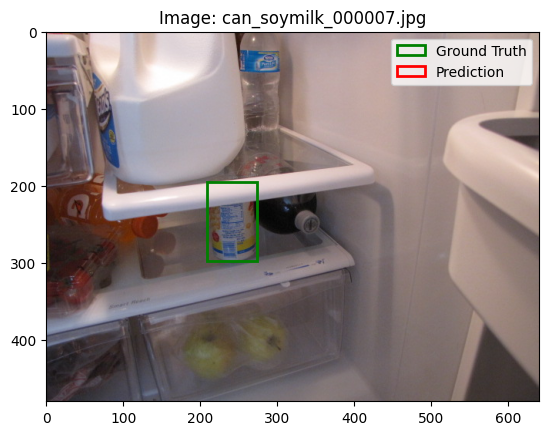

Performance for can_soymilk_000001.jpg: 0.0


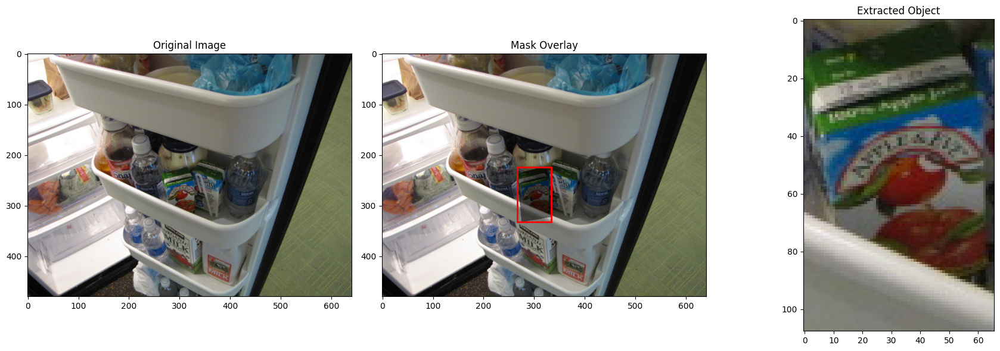

propagate in video: 100%|██████████| 2/2 [00:00<00:00,  7.24it/s]


creating index...
index created!
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0

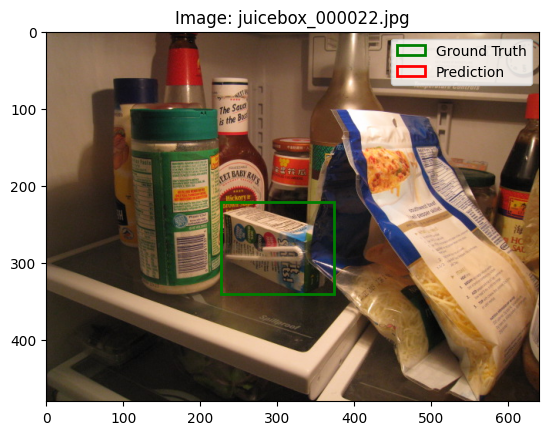

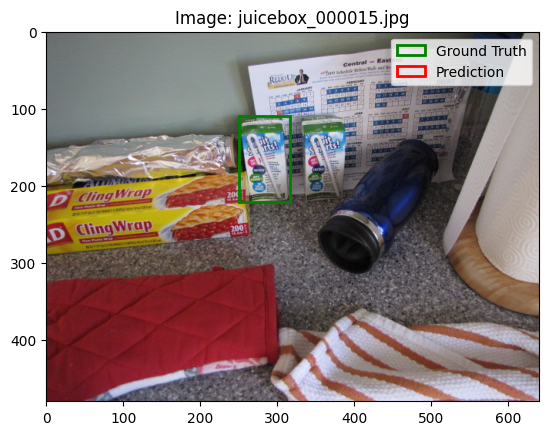

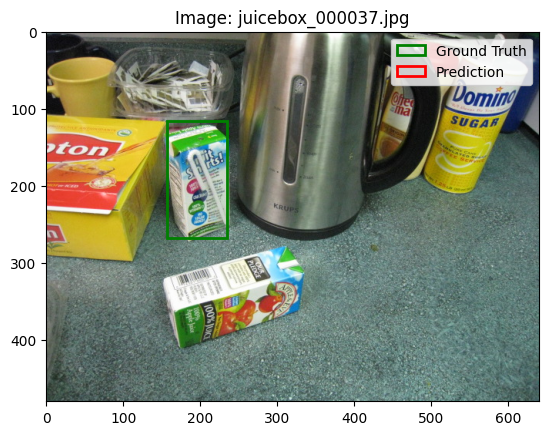

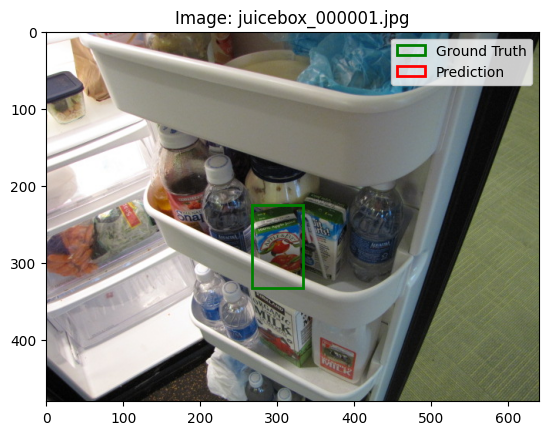

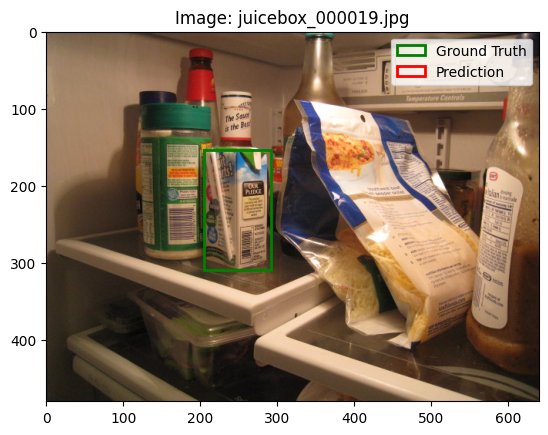

...

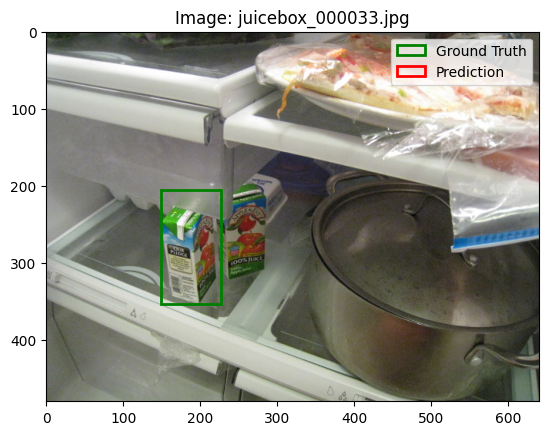

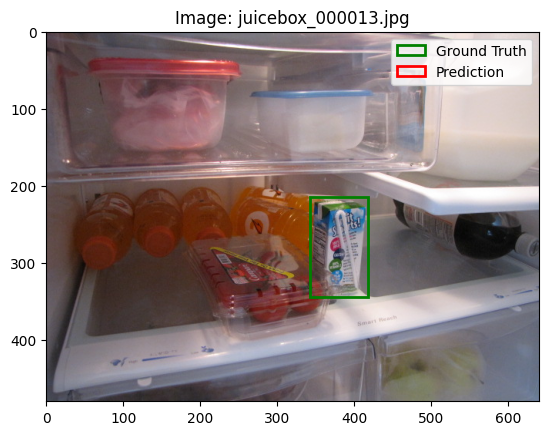

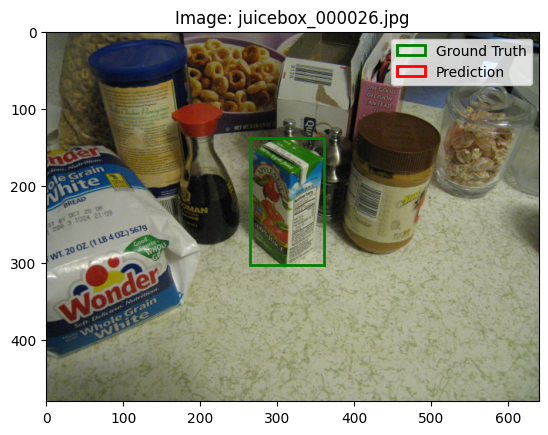

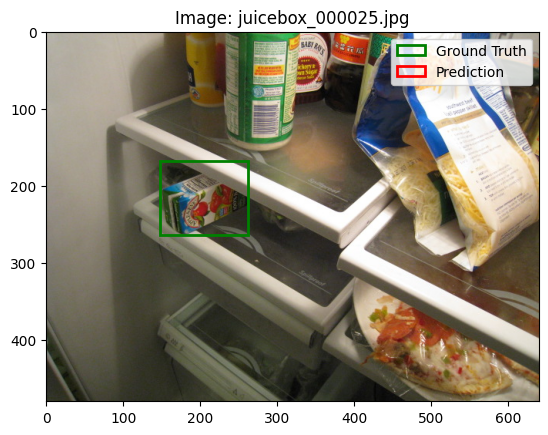

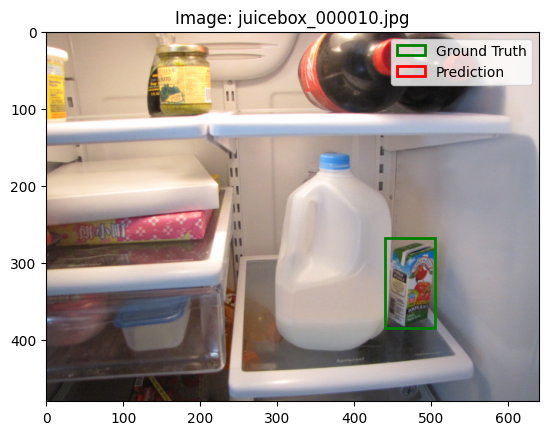

In [ ]:
import os
import numpy as np
import zipfile
import glob
import shutil
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches


# Function to track objects and calculate performance
def track_and_evaluate(product_first_img_path, product_first_mask_path, product_images):
    # Process the first image and its mask to get bounding box
    xmin, xmax, ymin, ymax = process_img_png_mask(product_first_img_path, product_first_mask_path, visualize=True)

    # Initialize empty lists for predictions and ground truth
    all_predictions = []
    all_ground_truths = []

    # Iterate over other images of the same product to track object
    for img_path in product_images:
        # Apply object tracking
        op = track_item_boxes(product_first_img_path, img_path, [([xmin, xmax, ymin, ymax], 1)], visualize=False)

        # Ground truth mask path
        mask_path = img_path.replace(".jpg", "_1_gt.png")
        if os.path.exists(mask_path):
            gt_xmin, gt_xmax, gt_ymin, gt_ymax = process_img_png_mask(img_path, mask_path, visualize=False)
            all_ground_truths.append([gt_xmin, gt_ymin, gt_xmax, gt_ymax])

        # Get the output mask from SAM2
        output_masks = op[1]
        if 1 in output_masks:
          relevant_mask = output_masks[1]
                # Reshape the relevant_mask to 2D if it's not
          if relevant_mask.ndim > 2:
            relevant_mask = relevant_mask[:, :, 0]  # Assuming the first channel is relevant
          # Find the indices of the minimum value along axis 0
          min_indices = np.where(relevant_mask == relevant_mask.min())
          # Get the first occurrence of the minimum value's indices
          pred_ymin, pred_xmin = min_indices[0][0], min_indices[1][0]

          # Find the indices of the maximum value along axis 0
          max_indices = np.where(relevant_mask == relevant_mask.max())
          # Get the first occurrence of the maximum value's indices
          pred_ymax, pred_xmax = max_indices[0][0], max_indices[1][0]

          all_predictions.append([pred_xmin, pred_ymin, pred_xmax, pred_ymax])

    # mAP = calculate_map(all_ground_truths, all_predictions)
    # Calculate object detection performance


# Function to calculate object detection performance using COCO metrics

    def calculate_performance(ground_truths, predictions, product_images):
        # Format ground truths and predictions in COCO format for evaluation
        coco_gt = {
            'images': [{'id': i} for i in range(len(ground_truths))],
            'annotations': [
                {'id': i, 'bbox': gt_bbox, 'image_id': i, 'category_id': 1,'iscrowd':0,'area': gt_bbox[2] * gt_bbox[3]}
                for i, gt_bbox in enumerate(ground_truths)
            ],
            'categories': [{'id': 1, 'name': 'object'}]
        }

        coco_pred = [
            {'image_id': i, 'bbox': pred_bbox, 'category_id': 1, 'score': 1.0}
            for i, pred_bbox in enumerate(predictions)
        ]

        # Create COCO objects for ground truth and predictions
        coco_gt_obj = COCO()
        coco_gt_obj.dataset = coco_gt
        coco_gt_obj.createIndex()

        coco_pred_obj = coco_gt_obj.loadRes(coco_pred)

        # Evaluate
        coco_eval = COCOeval(coco_gt_obj, coco_pred_obj, 'bbox')
        coco_eval.evaluate()
        coco_eval.accumulate()
        coco_eval.summarize()

        # Visualize the performance for each image
        for idx, img_path in enumerate(product_images):
            visualize_image_with_boxes(img_path, ground_truths[idx], predictions[idx])

        return coco_eval.stats[0]  # Return Average Precision (AP) as performance


    def visualize_image_with_boxes(image_path, gt_bbox, pred_bbox):
        """
        Visualize the image with ground truth and predicted bounding boxes overlaid.
        Ground truth box is in green, predicted box is in red.
        """
        # Load the image
        img = Image.open(image_path)

        # Create a figure and axis to display the image
        fig, ax = plt.subplots(1)
        ax.imshow(img)

        # Add the ground truth bounding box (green)
        gt_rect = patches.Rectangle((gt_bbox[0], gt_bbox[1]), gt_bbox[2] - gt_bbox[0], gt_bbox[3] - gt_bbox[1],
                                    linewidth=2, edgecolor='green', facecolor='none', label="Ground Truth")
        ax.add_patch(gt_rect)

        # Add the predicted bounding box (red)
        pred_rect = patches.Rectangle((pred_bbox[0], pred_bbox[1]), pred_bbox[2] - pred_bbox[0], pred_bbox[3] - pred_bbox[1],
                                      linewidth=2, edgecolor='red', facecolor='none', label="Prediction")
        ax.add_patch(pred_rect)

        # Set the title and display the legend
        ax.set_title(f"Image: {os.path.basename(image_path)}")
        ax.legend(handles=[gt_rect, pred_rect])

        # Display the image with overlaid bounding boxes
        plt.show()

    performance = calculate_performance(all_ground_truths, all_predictions,product_images)
    print(f"Performance for {os.path.basename(product_first_img_path)}: {performance}")

# Iterate over products, apply process_img_png_mask and track_item_boxes
for product_first_img_path in product_image_list:
    # Find the corresponding mask for the first image
    product_first_mask_path = product_first_img_path.replace(".jpg", "_1_gt.png")

    # Get all images of the product
    product_prefix = os.path.basename(product_first_img_path).split('_000001')[0]
    product_images = glob.glob(os.path.join(data_2d_dir, f"{product_prefix}_*.jpg"))

    # Apply tracking and evaluation
    track_and_evaluate(product_first_img_path, product_first_mask_path, product_images)

    # mAP = calculate_map(gt_masks, pred_masks)
    # visualize_results(image_paths, gt_masks, pred_masks, mAP)
